<a href="https://colab.research.google.com/github/cynthialmy/colab/blob/main/programming_task.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Analyzing a short video sequence for data lake searchability

### Task B.2.1: Feature Identification in Video Sequence



#### Importing Libraries and Loading Data
Before we start with the main tasks, we need to import all necessary libraries and load our dataset. This involves mounting the drive, checking the contents of our data directory, and importing libraries for image processing and deep learning.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls "/content/drive/MyDrive/Colab Notebooks/data" # load the data from the correct location from google drive

lake  new


In [ ]:
import os
import cv2
import numpy as np
from torchvision import transforms, models
from torch.utils.data import Dataset, DataLoader
import torch
from PIL import Image

#### Defining a Custom Dataset Class
To handle our images efficiently, we define a custom `Dataset` class. This will allow us to load images from the disk only when needed, apply transformations, and manage our dataset's size easily.

In [ ]:
class ImageDataset(Dataset):
    def __init__(self, folder_path):
        self.imgs_path = folder_path
        self.data = sorted([os.path.join(folder_path, img) for img in os.listdir(folder_path)])
        self.transform = transforms.Compose([
            transforms.Resize((640, 480)),
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
        ])
        self.to_tensor = transforms.ToTensor()

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        img_path = self.data[idx]
        img = Image.open(img_path).convert("RGB")
        original_size = img.size
        img_t = self.transform(img)
        original_img = self.to_tensor(img)  # Convert original image to tensor
        return img_t, original_img, original_size

#### Loading the Dataset and Models
Now, we load the dataset and initialize the DataLoader for batch processing. We also load pre-trained models for object detection and feature extraction. This sets the stage for feature identification from each image.

In [ ]:
# Load dataset
lake_dataset = ImageDataset("/content/drive/MyDrive/Colab Notebooks/data/lake") # load the data from the correct location from google drive
lake_loader = DataLoader(lake_dataset, batch_size=1, shuffle=False)

#### Feature Extraction and Bounding Box Detection
For each image, we need to identify key features and detect bounding boxes around objects. These features are crucial for the searchability of images in our data lake.

In [ ]:
# COCO dataset class labels
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'street sign', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'hat', 'backpack', 'umbrella', 'shoe', 'eye glasses',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'plate', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl', 'banana', 'apple',
    'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza', 'donut', 'cake', 'chair', 'couch',
    'potted plant', 'bed', 'mirror', 'dining table', 'window', 'desk', 'toilet', 'door', 'tv', 'laptop',
    'mouse', 'remote', 'keyboard', 'cell phone', 'microwave', 'oven', 'toaster', 'sink', 'refrigerator',
    'blender', 'book', 'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

In [ ]:
from torchvision.transforms import functional as F
from torchvision.ops import nms
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models import resnet50
from torch.nn.functional import adaptive_avg_pool2d
import torch

# Load pre-trained models
object_detection_model = fasterrcnn_resnet50_fpn(pretrained=True)
object_detection_model.eval()

feature_extraction_model = resnet50(pretrained=True)
feature_extraction_model = torch.nn.Sequential(*list(feature_extraction_model.children())[:-2])
feature_extraction_model.eval()

def extract_features_and_bbox(image_tensor):
    with torch.no_grad():
        # Process the input images as a batch
        batch = image_tensor if image_tensor.dim() == 4 else image_tensor.unsqueeze(0)
        # batch = F.crop(batch, top=0, left=0, height=int(batch.shape[2] * 4 / 5), width=batch.shape[3])  # Crop the bottom 1/5 of the images
        batch = F.crop(batch, top=int(batch.shape[2] / 5), left=0, height=int(batch.shape[2] * 3 / 5), width=batch.shape[3])

        # Object detection
        detection_results = object_detection_model(batch)
        features_per_object, bboxes, labels = [], [], []

        for img_num, (detections, image) in enumerate(zip(detection_results, batch)):
            boxes = detections['boxes']
            scores = detections['scores']
            det_labels = detections['labels']
            keep = nms(boxes, scores, 0.3)  # Apply NMS with a threshold of 0.3

            # Dynamic thresholding (e.g., based on the average score)
            dynamic_threshold = scores[keep].mean() * 0.75  # 75% of the average score

            for i in keep:
                if scores[i] >= dynamic_threshold:  # Using dynamic threshold
                    bbox = boxes[i]
                    label = COCO_INSTANCE_CATEGORY_NAMES[det_labels[i]]
                    object_img = F.crop(image, top=int(bbox[1]), left=int(bbox[0]), height=int(bbox[3]-bbox[1]), width=int(bbox[2]-bbox[0]))
                    object_img = F.resize(object_img, (640, 480), antialias=True)
                    object_features = feature_extraction_model(object_img.unsqueeze(0))
                    object_features = adaptive_avg_pool2d(object_features, (1, 1)).view(-1).cpu().numpy()

                    features_per_object.append(object_features)
                    bboxes.append(bbox.cpu().numpy())
                    labels.append(label)

    return features_per_object, bboxes, labels


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 115MB/s]
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None

#### Visualizing Results on Images
Visual representation is key for interpretability. Here, we overlay the detected features and bounding boxes on the original images, providing a clear visualization of our model's performance.


In [ ]:
import numpy as np
import cv2

def visualize_results(image_pil, bboxes, features_per_object):
    draw = ImageDraw.Draw(image_pil)
    for bbox, features in zip(bboxes, features_per_object):
        # Draw bounding box
        draw.rectangle(((bbox[0], bbox[1]), (bbox[2], bbox[3])), outline="red")

        # Placeholder for feature visualization (modify as needed)
        # For example, overlay feature vector values (first 5 values for brevity)
        text = ', '.join(f'{feature:.2f}' for feature in features[:5])
        draw.text((bbox[0], bbox[1]), text, fill="red")

    return np.array(image_pil)


In [ ]:
from PIL import ImageDraw, ImageFont

def visualize_results(image_pil, bboxes, features_per_object, labels):
    draw = ImageDraw.Draw(image_pil)
    # Optionally, specify a font size
    # Inside visualize_results function
    try:
        # Try to use a specific font file if it's available
        font = ImageFont.truetype("arial.ttf", 15)
    except IOError:
        # If the specific font file is not available, use a default font
        font = ImageFont.load_default()

    for bbox, features, label in zip(bboxes, features_per_object, labels):
        # Draw bounding box
        draw.rectangle(((bbox[0], bbox[1]), (bbox[2], bbox[3])), outline="red")

        # Draw label
        label_text = f'{label}'
        draw.text((bbox[0], bbox[1] - 10), label_text, fill="yellow", font=font)

        # For example, overlay feature vector values (first 5 values for brevity)
        feature_text = ', '.join(f'{feature:.2f}' for feature in features[:5])
        draw.text((bbox[0], bbox[3]), feature_text, fill="blue", font=font)

    return np.array(image_pil)


### Task B.2.2: Rendering Features with Video


#### Processing Video Frames and Generating Output Video
We process each frame of the video sequence, extract features, detect objects, and then overlay these results on the video frames. This enhanced video helps in understanding the model's performance over a sequence of images.

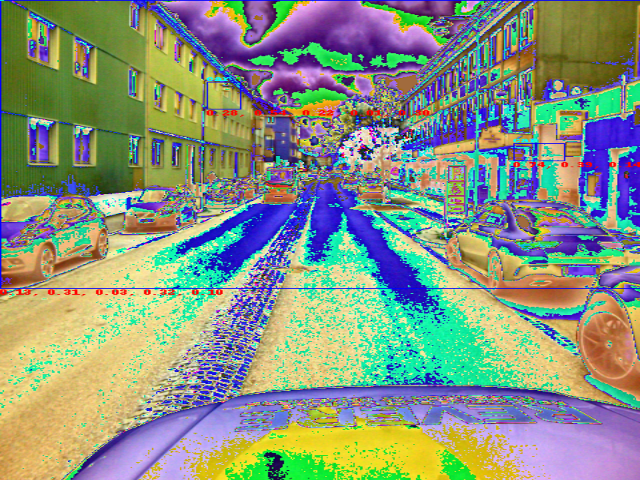

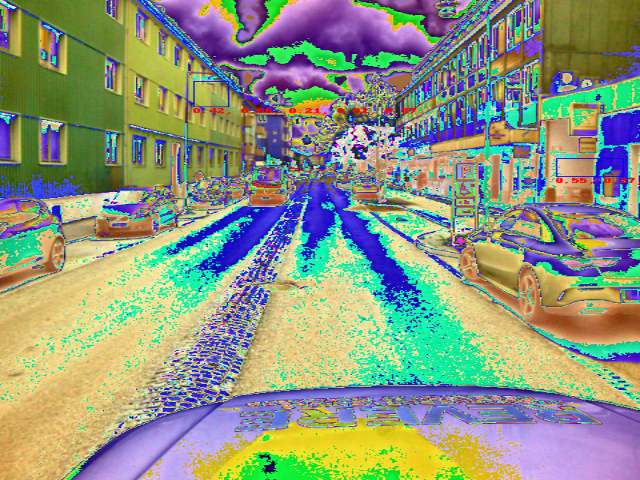

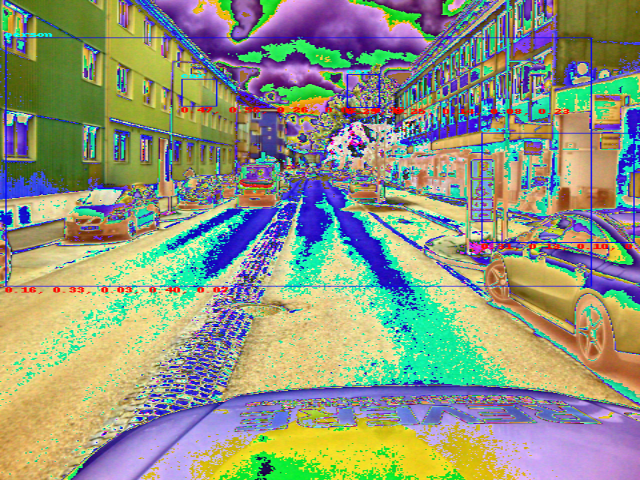

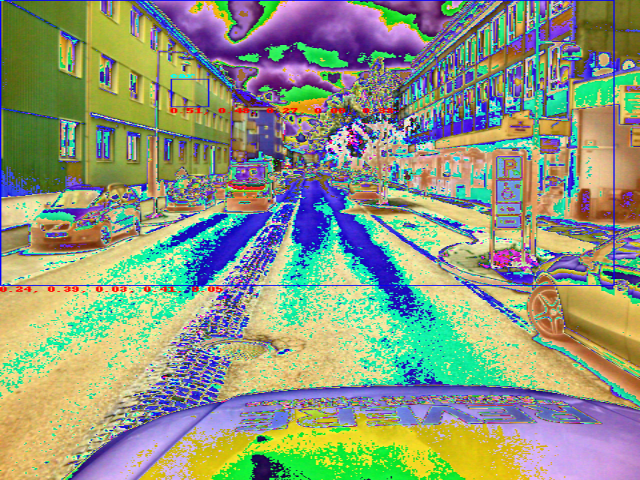

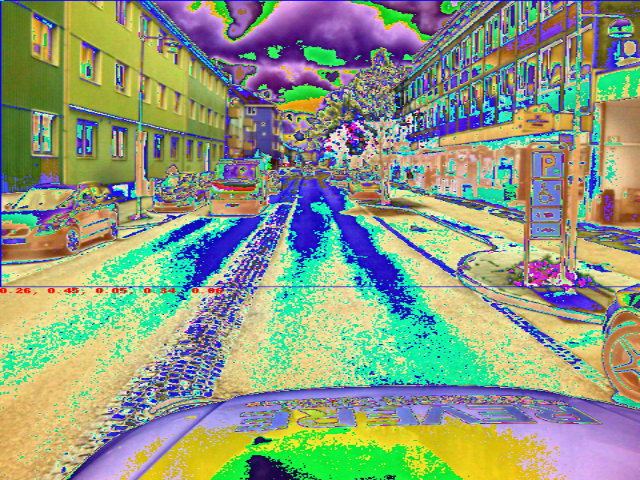

...

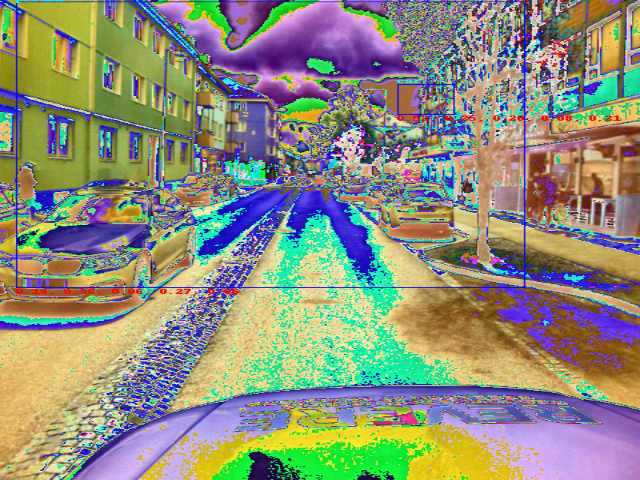

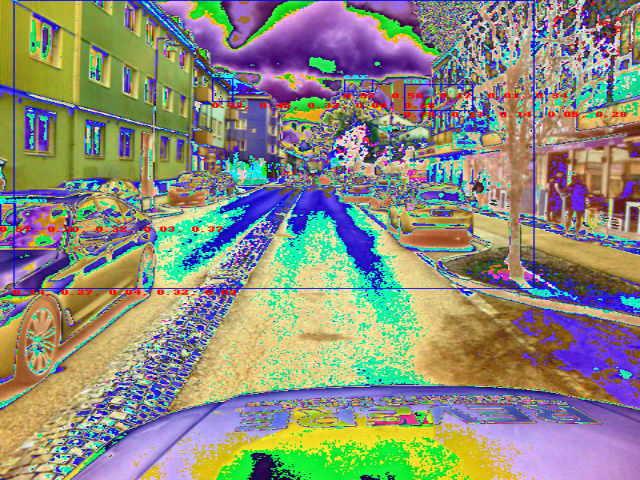

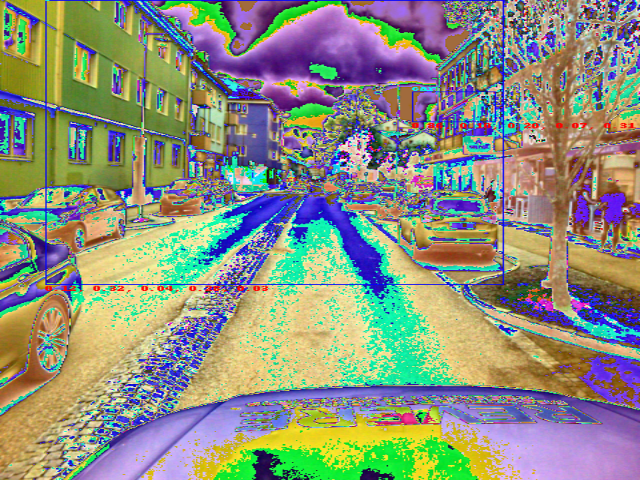

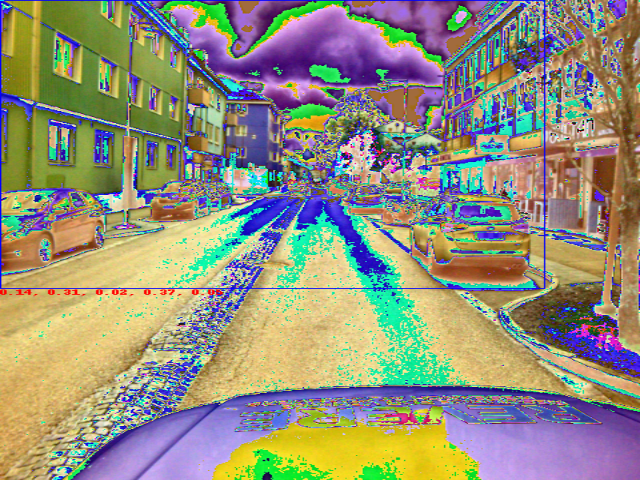

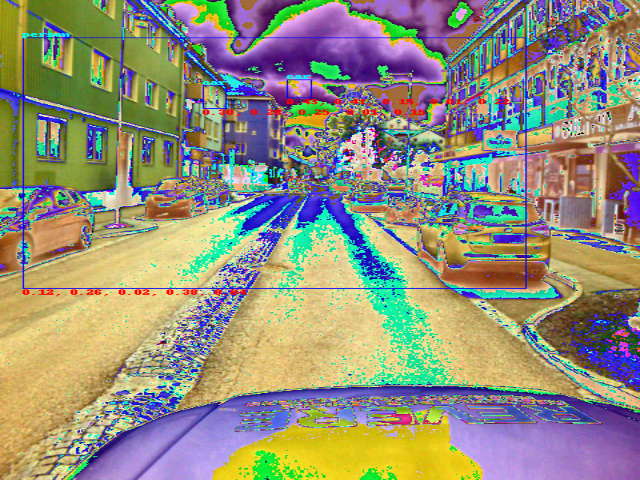

In [ ]:
from google.colab.patches import cv2_imshow
fourcc = cv2.VideoWriter_fourcc(*'MP4V')
out = cv2.VideoWriter('/content/drive/MyDrive/Colab Notebooks/output_video_feature.mp4', fourcc, 10.0, (640, 480))

lake_features = []
lake_bboxes = []
lake_labels = []

for img_t, _, original_size in lake_loader:
    # Extract features, bounding boxes, and labels
    features_per_object, bboxes, labels = extract_features_and_bbox(img_t)
    lake_features.extend(features_per_object)
    lake_bboxes.extend(bboxes)
    lake_labels.extend(labels)

    # Convert tensor image to PIL for drawing
    original_img_pil = F.to_pil_image(img_t.squeeze(0))

    # Visualize results
    visualization = visualize_results(original_img_pil, bboxes, features_per_object, labels)

    # Resize to match the frame size and write to the video
    visualization_resized = cv2.resize(visualization, (640, 480))
    cv2_imshow(visualization_resized)  # Note: cv2_imshow is used in Jupyter notebooks. Use cv2.imshow for standalone scripts.
    out.write(visualization_resized)

# Release everything when the job is finished
out.release()


### Task B.2.3: Novelty Detection in New Images



#### Novelty Detection in New Images
Given new images, we need to assess their novelty compared to the existing images in the database. This involves comparing feature similarities and identifying images that are sufficiently different from those in our data lake.

In [ ]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity

def compare_image_similarity(new_features, existing_features):
    # Ensure that both new and existing features are numpy arrays
    new_features = np.array(new_features)
    existing_features = np.array(existing_features)

    # Calculate cosine similarity between the new image and existing features
    similarity_scores = cosine_similarity(new_features, existing_features)

    # Calculate the mean similarity score (can also use max, min, etc.)
    mean_similarity = np.mean(similarity_scores)

    return mean_similarity

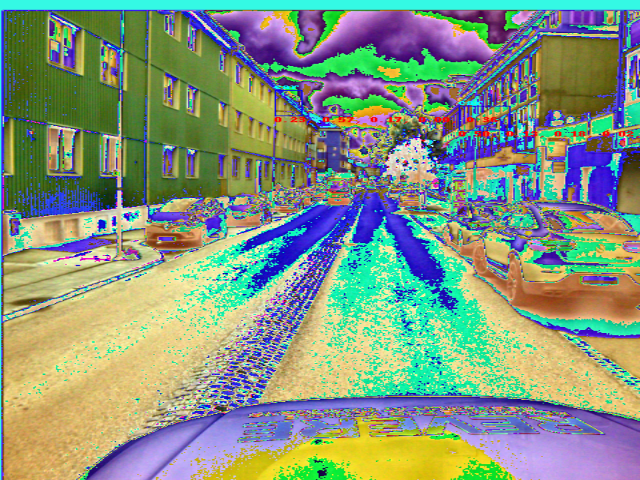

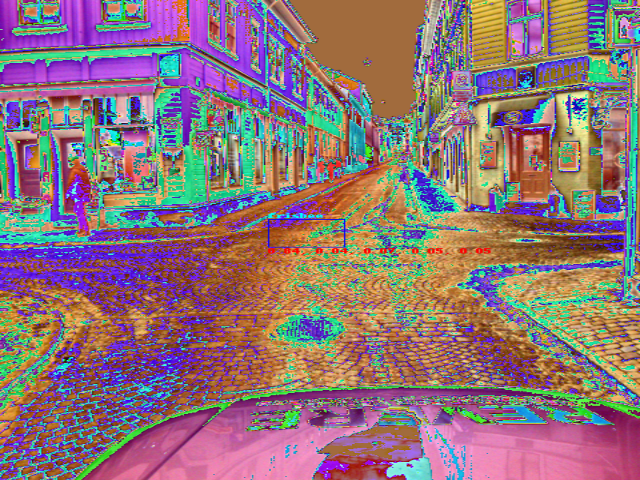

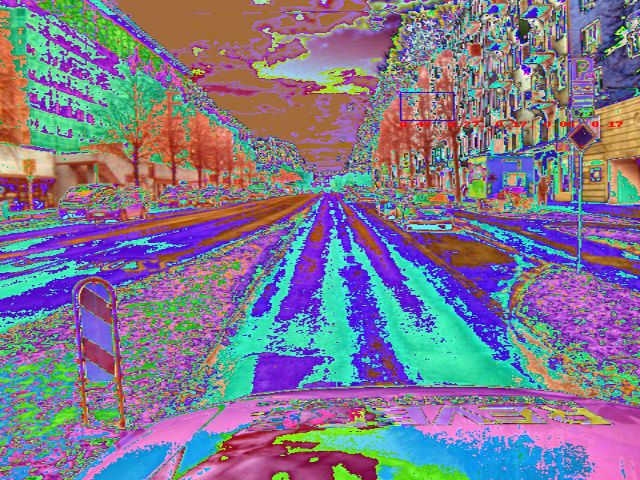

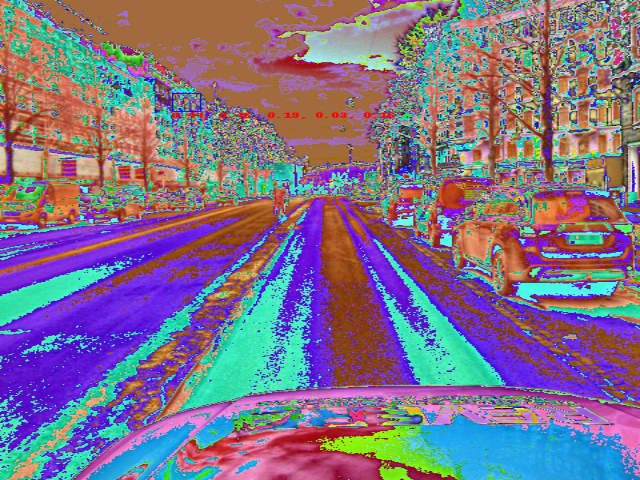

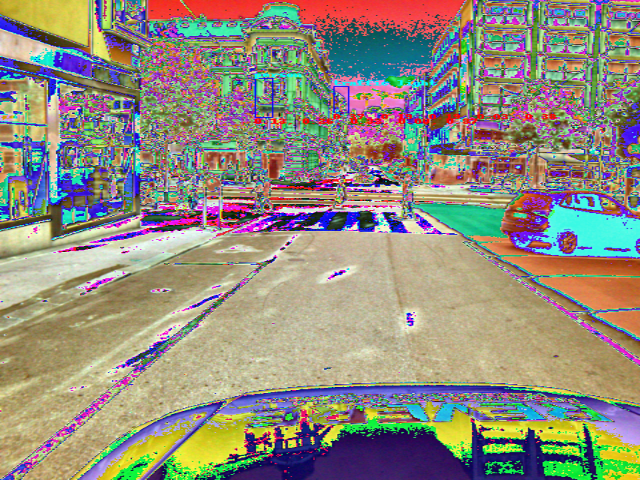

[0.7281794, 0.6351406, 0.7557819, 0.7174937, 0.6622568]


In [ ]:
new_dataset = ImageDataset("/content/drive/MyDrive/Colab Notebooks/data/new") # load the data from the correct location from google drive
new_loader = DataLoader(new_dataset, batch_size=1, shuffle=False)

similarities = []
for img_t, _, _ in new_loader:
    features_per_object, bboxes, labels= extract_features_and_bbox(img_t)

    # Convert tensor image to PIL for drawing
    original_img_pil = F.to_pil_image(img_t.squeeze(0))

    # Visualize results
    visualization = visualize_results(original_img_pil, bboxes, features_per_object, labels)

    # Resize to match the frame size and write to the video
    visualization_resized = cv2.resize(visualization, (640, 480))

    cv2_imshow(visualization_resized)

    if len(features_per_object):
      similarities.append(compare_image_similarity(features_per_object, lake_features))
    else:
      similarities.append(0)

print(similarities)

#### Identifying and Displaying Novel Images
To determine which new images are "interesting enough" to be logged into the data lake, we calculate a novelty threshold. Images with similarity scores below this threshold are considered novel and are then displayed.

Image 1 is novel.


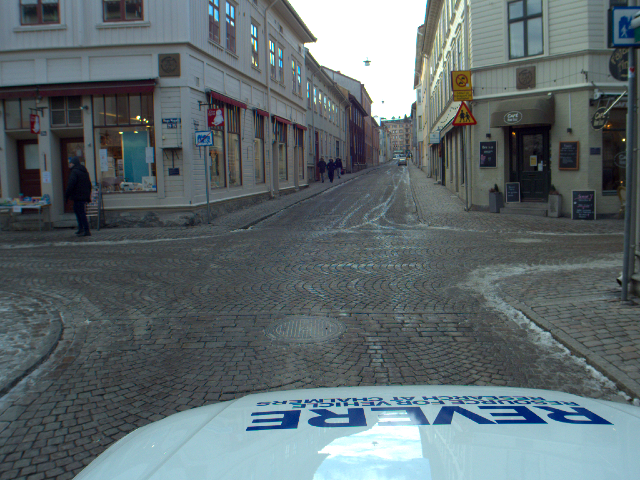

Image 4 is novel.


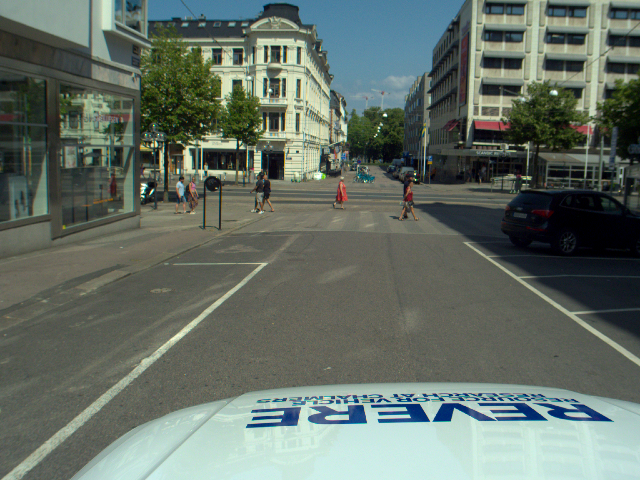

In [ ]:
from google.colab.patches import cv2_imshow
# Threshold to consider an image as novel
novelty_threshold = np.percentile(similarities, 50)

# Find indices of novel images
novel_indices = np.where(similarities < novelty_threshold)[0]

# Output results
for idx in novel_indices:
    print(f"Image {idx} is novel.")

    # Optionally, show the novel image
    novel_img = cv2.imread(new_dataset.data[idx])
    novel_img = cv2.resize(novel_img, (640, 480))
    cv2_imshow(novel_img)

cv2.destroyAllWindows()


In [ ]:
# Print similarities for each new image
for idx, similarity in enumerate(similarities):
    print(f"Image {idx} similarities to 'lake' images: {similarity}")

Image 0 similarities to 'lake' images: 0.728179395198822
Image 1 similarities to 'lake' images: 0.635140597820282
Image 2 similarities to 'lake' images: 0.755781888961792
Image 3 similarities to 'lake' images: 0.7174937129020691
Image 4 similarities to 'lake' images: 0.6622567772865295


# Reflection

Given 20 images in the data lake and 5 new images, the decision was to use pre-trained models (fasterrcnn_resnet50_fpn for object detection and resnet50 for feature extraction). The system's ability to flag images 1 and 4 as the most "interesting" was alighed with intuition, indicating that the novelty detection components are functioning.

However, the system's performance in feature extraction is not ideal. The presence of missed or incorrectly identified objects could due to that the COCO dataset may not align well with the specific characteristics of the images in our data lake (street scenes captured from vehicles).


## 1. Are there any hyperparameters for your model? If so, how do you systematically choose and optimize them?

In the project, pre-trained models (`fasterrcnn_resnet50_fpn` and `resnet50`) were used with hyperparameters initially optimized through trial and test, including:


### 1. Object Detection Model (`fasterrcnn_resnet50_fpn`):
- **Non-Maximum Suppression (NMS) Threshold**: It's used to decide which boxes to keep. A lower threshold 0.3 is more stringent, removing more boxes.

- **Dynamic Threshold for Scores**: I used a dynamic threshold set to 75% of the average score of detected boxes.

### 2. Feature Extraction Model (`resnet50`):
- **Image Resizing and Cropping Parameters**: Decisions about the size of input images and whether to crop parts of the image.
- **Layer of Feature Extraction**: I currently use all layers except the last two.

### 3. Novelty Detection:
- **Novelty Threshold**: I used the 50th percentile of similarity scores to decide which images are novel.

### Possible Optimization Approach:
- **Grid Search or Random Search**: Systematically iterate over a range of values for NMS and dynamic thresholds to find the combination that maximizes the model's accuracy or another relevant performance metric.
- **Cross-validation**: Use part of the data lake images as a validation set to avoid overfitting during hyperparameter tuning.
- **Receiver Operating Characteristic (ROC) Curve**: If possible, create a ROC curve by treating the novelty score as a binary classification problem to find an optimal balance between true positive rate and false positive rate.



## 2. Are the results expected? How did you test and validate the outcomes of your model during development?

The results, where images 1 and 4 were identified as the most novel additions to the data lake, aligned well with intuitive expectations (intersections coming up, different texure of the road surface, pedestrain crossing).

This suggests that the novelty detection components are  capturing the essence of novelty in the dataset.

However, the presence of missed or incorrectly identified objects indicates room for improvement in object detection accuracy.

During development, the model's performance was tested and validated using:

- **Visual Inspection**: Visualizing the overlaid bounding boxes and extracted features on the images allowed for qualitative assessment using `visualize_results` function. This was particularly useful for ensuring that the model's interpretations aligned with human intuition.

- **Quantitative Measures**: The similarity scores are also ouput to show how similar the new images are to the data lake for a quantitive validation.




## 3. Why are the identified features critical for enhancing the searchability of images or video sequences in a database?

Features capture essential details like shapes, textures, colors, and the presence of specific objects, enabling the system to understand and catalog the content without human intervention in 3 major ways:

1. By identifying and extracting features associated with objects (e.g., cars, trees) and their characteristics, the system allows for **semantic search** queries that are easier for human to interact with.

2. Features help in identifying unique content by distinguishing between similar and dissimilar images. This aids in **reducing redundancy** in the database and highlighting novel content, thereby ensuring that the database remains diverse and relevant.

3. Feature-based indexing allows for **quicker retrieval** of images or videos. Instead of sifting through entire files, the system can compare feature vectors, significantly speeding up the search process.





## 4. What approach did you use to evaluate the “novelty” of the new images, and how does it ensure robustness against out-of-distribution data?

To evaluate the "novelty" of new images, the cosine similarity was performed between the feature vectors of the new images and those of the existing images in the data lake.

This metric measures the cosine of the angle between two vectors, in this case, the feature vectors of the images. It's effective because it captures the orientation (i.e., the information content) rather than the magnitude (i.e., the size or length of the feature vector), making it scale-invariant and focused on the pattern of the data.

The system can continually incorporate new images into the data lake as it learns from the new data it encounters.

## 5. Explain how your approach scales when applied to a data lake with potentially petabytes of data. What might be the bottlenecks? How would you mitigate them?

**Bottleneck 1: Intensive Computation & Memory Usage**

For the computationally demanding tasks like feature extraction (`extract_features_and_bbox`) and novelty detection (`compare_image_similarity`), mitigate by:
- **Model Optimization**: Utilize model pruning, quantization, and knowledge distillation to streamline the model without sacrificing accuracy.
- **GPU Acceleration**: Harness GPUs for parallel image data processing, expediting tasks like feature extraction and object detection.
- **Distributed Computing**: Employ frameworks like Apache Spark or Dask for parallelizing tasks across computing resources.

**Bottleneck 2: Slow Data Loading**

We can address loading large datasets, especially from inefficient storage, by:
- **In-memory Databases**: Opt for fast, in-memory databases (e.g., Redis, Memcached) to swiftly fetch data compared to disk storage.
- **Data Pre-fetching**: Load the next data batch in the background during current batch processing, ensuring seamless continuity.
- **Data Formats**: Use formats like Parquet for efficient columnar storage, compression, and swift I/O operations.
- **Space-Filling Curves (SFC)**: Enhance efficiency by linearizing multi-dimensional data storage and indexing, ensuring proximity in storage reflects closeness in multi-dimensional space. This aids in efficient querying and retrieval, especially beneficial for similarity searches in the data lake.